In [1]:
pip install pynvml

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
%%shell

# pour installer engine afin d'utiliser train_one_epoch
git clone https://github.com/pytorch/vision.git
cd vision
git checkout v0.8.2

Cloning into 'vision'...
remote: Enumerating objects: 271642, done.
remote: Counting objects: 100% (10843/10843), done.
remote: Compressing objects: 100% (565/565), done.
remote: Total 271642 (delta 10329), reused 10751 (delta 10257), pack-reused 260799
Receiving objects: 100% (271642/271642), 543.95 MiB | 37.17 MiB/s, done.
Resolving deltas: 100% (248098/248098), done.
Note: checking out 'v0.8.2'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now at 2f40a483d7 [v0.8.X] .circleci: Add Python 3.9 to CI (#3063)


In [2]:
# pour installer engine afin d'utiliser train_one_epoch
!cp drive/MyDrive/vision/references/detection/utils.py .
!cp drive/MyDrive/vision/references/detection/transforms.py .
!cp drive/MyDrive/vision/references/detection/coco_eval.py .
!cp drive/MyDrive/vision/references/detection/engine.py .
!cp drive/MyDrive/vision/references/detection/coco_utils.py .

In [3]:
cd drive/MyDrive

/content/drive/MyDrive


In [4]:
from pynvml import *
from tqdm import tqdm
import matplotlib.pyplot as plt
import glob
import numpy as np
import json
import torch
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import torch.nn.functional
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from PIL import Image
from torchvision import transforms
from matplotlib.patches import Rectangle
from engine import train_one_epoch, evaluate
import pathlib
from torch.optim.lr_scheduler import StepLR

In [5]:
# pour afficher la mémoire libre/utilisée de la GPU (il faut être en mode GPU)
# pour lancer le training il faut vérifier que toute la mémoire de la GPU est libre sinon redémarrer l'environnement d'exécution.

nvmlInit()
h = nvmlDeviceGetHandleByIndex(0)
info = nvmlDeviceGetMemoryInfo(h)
print(f'total    : {info.total // 1024 ** 2 }') 
print(f'free     : {info.free // 1024 ** 2 }')
print(f'used     : {info.used // 1024 ** 2 }') 

total    : 15109
free     : 15109
used     : 0


In [6]:
# 1
# dossier des images

images_train_directory =  os.path.join(os.environ["HOME"], '/content/drive/MyDrive/train/image')

images_test_directory = os.path.join(os.environ["HOME"], '/content/drive/MyDrive/test/image')


#dossier des json
json_train_directory = os.path.join(os.environ["HOME"], '/content/drive/MyDrive/train/json')

json_test_directory = os.path.join(os.environ["HOME"], '/content/drive/MyDrive/test/json')

In [7]:
images_train_directory

'/content/drive/MyDrive/train/image'

In [8]:
# 2
# liste des images des reçus 
images_train_filenames = list(sorted(os.listdir(images_train_directory)))
images_test_filenames = list(sorted(os.listdir(images_test_directory)))

#liste des json des reçus
json_train_filenames = list(sorted(os.listdir(json_train_directory)))
json_test_filenames = list(sorted(os.listdir(json_test_directory)))

In [9]:
len(images_train_filenames)

799

In [12]:
len(images_test_filenames)

100

In [10]:
len(json_train_filenames)

799

In [11]:
len(json_test_filenames)

100

In [13]:
#3
def get_data_in_list(file):

    valid_line = file['valid_line']

    #si le prix total est manquant on essaie d'ajouter les autres infos par ordre d'importance

    #prix total
    data=[]  
    for elt in valid_line:
      if elt["category"] == 'total.total_price':
        data = [elt] 
      
    #si prix total manquant, montant payer par carte 
    for elt in valid_line:
      if elt["category"] == 'total.creditcardprice' and len(data) == 0:  # data non initialisé
      # if elt["category"] == 'total.creditcardprice':
        data = [elt]  

    #si prix total manquant, montant payer par carte manquant donc montant payer en cash
    for elt in valid_line:
      if elt["category"] == 'total.cashprice' and len(data) == 0:
        data = [elt] 

    #si prix total manquant, montant payer en cash manquant et  monnaie rendue manquante donc monnaie rendue    
    for elt in valid_line:
      if elt["category"] == 'total.changeprice' and len(data) == 0:
        data = [elt]    

    #si prix total manquant, montant payer en cash manquant, monnaie rendu manquante et montant payer par carte manquant donc montant sans frais
    for elt in valid_line:
      if elt["category"] == 'sub_total.subtotal_price' and len(data) == 0:
        data = [elt]

    #sinon manque d'information
      
    return data

      
   

In [14]:
#4
def get_data_from_list(data):
  if len(data) != 0:
     for p in data:
        words = p['words']

        for x in words :
          price_value=[]
          price_title=[]
          if x['is_key'] == 0:

            # met les coodonnées du rectangle contenant le prix
            price_value = [x['quad']]
          else :

            #met les coordonnées du rectangle contenant le titre du prix
            price_title = [x['quad']]

          if len(price_value) > 0:
              if len(price_title) > 0:
                  # si on a le prix et le titre
                  # 4 valeurs suffisent pour définir un rectangle car x1=x4 , y1=y2 , x4=x1, x3=x2 et y4=y3
                  return np.array([price_title[0]['x1'],price_title[0]['y1'],price_value[0]['x2'],price_title[0]['y4']])
              else:
                  # si titre du prix est manquant
                  return np.array([price_value[0]['x1'], price_value[0]['y1'],price_value[0]['x2'], price_value[0]['y4']])
  # si les titre et prix sont manquants     
  return None


In [15]:
#test get_data_in_list et get_data_from_list
f = open(json_train_directory+'/'+json_train_filenames[10] , encoding='utf-8')

print(json_train_filenames[10])

data = json.load(f)

x = data['valid_line']

l=[]

l = get_data_in_list(data)

value = get_data_from_list(l)

print(value)

f.close()

receipt_00010.json
[351 278 386 291]


In [16]:
#5 la classe image + rectangle
class Image_Rectangle(Dataset):

    #Constructeur de la classe, pour initialiser les paths des images et des json pour train et test set ainsi que l'image
    def __init__(self, data_directory, train_or_test, image):
        self.data_directory = os.path.join(data_directory, train_or_test)
        self.train_or_test = train_or_test
        self.image = image
        self.images =  list(sorted(os.listdir(os.path.join(self.data_directory, 'image'))))
        self.json =  list(sorted(os.listdir(os.path.join(self.data_directory, 'json'))))

    def __len__(self):
        return self.images.__len__()
        
    #affiche le rectangle contenant prix + titre
    def affiche_rectangle(self,rectangle):
      return [rectangle[0], rectangle[1], rectangle[2], rectangle[3]]
    
    #retourne l'image + le rectangle qui contient le prix et le titre du prix (target)
    def __getitem__(self, index):
        image_file_name = self.images[index]
        image_path = os.path.join(self.data_directory, 'image', image_file_name)

        json_file_name = self.json[index]
        json_file_path = os.path.join(self.data_directory, 'json', json_file_name)

        # les 2 fonctions créées précédemment
        f = open(json_file_path, 'r',encoding='utf-8')
        data = json.load(f)
        data_list = []
        data_list = get_data_in_list(data)
        rectangle = get_data_from_list(data_list)
        f.close()

        image = Image.open(image_path)

        #affiche le rectangle contenant prix + titre
        if rectangle is not None:
          rectangle = self.affiche_rectangle(rectangle)

        if rectangle is None:
          print("////////////////////////////",image_file_name)
          
        image = self.image(image)

        # créé un représentant du rectangle (target) sous forme de tensor adapté au model
        target = {}
        target['boxes'] = torch.FloatTensor([rectangle])
        target['labels'] = torch.ones((1,), dtype=torch.int64)
        target['image_id'] = torch.tensor([index])
        target['area'] = torch.tensor([(rectangle[3] - rectangle[1]) * (rectangle[2] - rectangle[0])])  # attention si rectangle is None
        target['iscrowd'] = torch.zeros((1,), dtype=torch.int64)

        return image, target

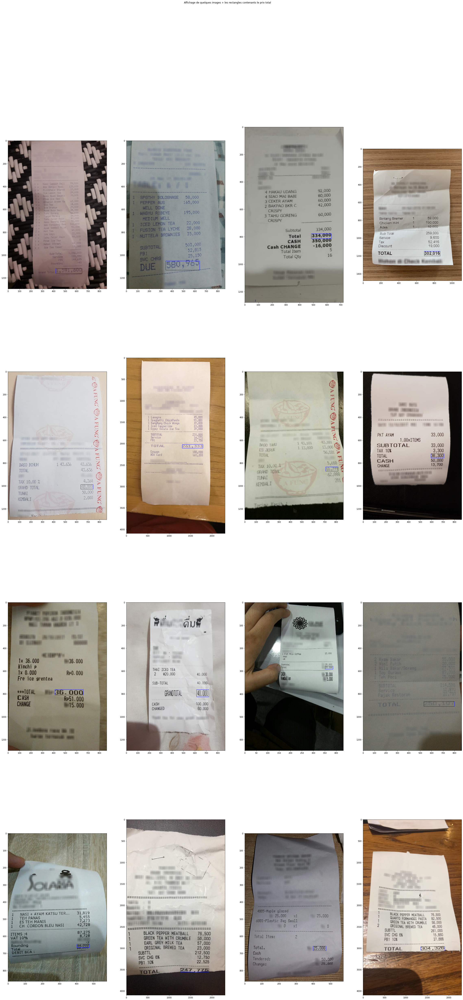

In [17]:
#6
#transformation de l'image en tensor
image = transforms.Compose([transforms.ToTensor()])

# data set et lecteur du data set
data = Image_Rectangle('/content/drive/MyDrive/', 'train', image)
data_loader = torch.utils.data.DataLoader(data)

#visualisation de quelques images
def visualize_data(dataset, n_rows, n_columns):
    indexes = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    
    fig, axs = plt.subplots(n_rows, n_columns, figsize=(40, 80))

    for idx, sample_idx in enumerate(indexes):
        image, rectangle = dataset[sample_idx]
        rectangle = rectangle["boxes"][0]
        image = transforms.ToPILImage()(image)
        axs[idx // n_columns, idx % n_columns].imshow(image)
        rectangle = Rectangle(xy=(rectangle[0], rectangle[1]), width=rectangle[2] - rectangle[0],height=rectangle[3] - rectangle[1],linewidth=1, edgecolor='b', facecolor='none')
        axs[idx // n_columns, idx % n_columns].add_patch(rectangle)
    plt.suptitle("Affichage de quelques images + les rectangles contenants le prix total")
    plt.show()      

visualize_data(dataset=data, n_rows=4, n_columns=4)
     

In [18]:
#7 le modèle
# load le modèle ResNet-50 FPN pré-entrainé 
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

num_classes = 2  # 1 pour le rectangle et 1 pour le fond

in_features = model.roi_heads.box_predictor.cls_score.in_features

# création du Fast R-CNN model
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [19]:
#8 training

def collate_fn(batch):
    return tuple(zip(*batch))

#utilisation du GPU
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

image = transforms.Compose([transforms.ToTensor()])
dataset = Image_Rectangle('/content/drive/MyDrive/', 'train', image)
dataset_validation = Image_Rectangle('/content/drive/MyDrive/', 'test', image) #ici le jeu de test est utilisé comme jeu de validation

# training et validation data loader
train_data_loader = torch.utils.data.DataLoader(dataset, batch_size=8, shuffle=True, num_workers=4, collate_fn=collate_fn)

data_loader_val = torch.utils.data.DataLoader(dataset_validation, batch_size=8, shuffle=False, num_workers=4, collate_fn=collate_fn)

model.to(device)

# construction du Adamw optimizer 
optimizer= torch.optim.AdamW(model.parameters(), lr=0.001)

lr_scheduler = StepLR(optimizer, step_size=2, gamma=0.1) 

# training avec 10 epochs
num_epochs = 10

for epoch in range(num_epochs):
    #training pour une epoch
    train_one_epoch(model, optimizer, train_data_loader, device, epoch, print_freq=100)

    #learning rate màj
    lr_scheduler.step()

    # evaluation sur le jeu de validation
    evaluate(model, data_loader_val, device=device)


/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch: [0]  [  0/100]  eta: 0:16:31  lr: 0.000011  loss: 1.7824 (1.7824)  loss_classifier: 1.3867 (1.3867)  loss_box_reg: 0.0080 (0.0080)  loss_objectness: 0.3623 (0.3623)  loss_rpn_box_reg: 0.0253 (0.0253)  time: 9.9156  data: 2.6779  max mem: 11502
Epoch: [0]  [ 99/100]  eta: 0:00:02  lr: 0.001000  loss: 0.0957 (0.1953)  loss_classifier: 0.0476 (0.1107)  loss_box_reg: 0.0323 (0.0516)  loss_objectness: 0.0087 (0.0240)  loss_rpn_box_reg: 0.0067 (0.0089)  time: 2.5512  data: 0.0547  max mem: 11581
Epoch: [0] Total time: 0:04:30 (2.7041 s / it)
creating index...
index created!
Test:  [ 0/13]  eta: 0:00:58  model_time: 1.1676 (1.1676)  evaluator_time: 0.0259 (0.0259)  time: 4.4640  data: 3.1149  max mem: 11581
Test:  [12/13]  eta: 0:00:01  model_time: 1.1205 (1.0735)  evaluator_time: 0.0043 (0.0077)  time: 1.4659  data: 0.3058  max mem: 11581
Test: Total time: 0:00:19 (1.4803 s / it)
Averaged stats: model_time: 1.1205 (1.0735)  evaluator_time: 0.0043 (0.0077)
Accumulating evaluation resul

In [20]:
torch.save(model,'/content/drive/MyDrive/fasterrcnn_resnet50_fpn.pt')

In [21]:
def visualize_prediction(model, dataset, rows, columns):

    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
    model.eval()
    indexes = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
    fig, axs = plt.subplots(rows, columns, figsize=(40, 80))
    for idx, sample_idx in enumerate(indexes):
        image,rectangle_ground_truth = dataset[sample_idx] # get a random image and its TTC bounding box 
        rectangle_ground_truth = rectangle_ground_truth["boxes"][0]

        # prediction pour une image
        predictions_rectangles = model([image.to(device)])[0]['boxes'].detach().cpu().numpy()

        # convertion de tensor en image
        image = transforms.ToPILImage()(image)

        axs[idx // columns, idx % columns].imshow(image)

        # creation du rectangle sur l'image
        rectangle_ground_truth = Rectangle(xy=(rectangle_ground_truth[0], rectangle_ground_truth[1]), width=rectangle_ground_truth[2] - rectangle_ground_truth[0],height=rectangle_ground_truth[3] - rectangle_ground_truth[1], linewidth=1, edgecolor='blue', facecolor='none')
        
        axs[idx // columns, idx % columns].add_patch(rectangle_ground_truth)

        #prediction du modèle
        rectangle_prediction = predictions_rectangles[0]
        rectangle_prediction = Rectangle(xy=(rectangle_prediction[0], rectangle_prediction[1]), width=rectangle_prediction[2] - rectangle_prediction[0],height=rectangle_prediction[3] - rectangle_prediction[1], linewidth=1, edgecolor='red', facecolor='none')
        axs[idx // columns, idx % columns].add_patch(rectangle_prediction)

    plt.suptitle('Visualsiation des prédictions du modèle resnet50_fpn en rouge les prédictions et en bleu la vérité terrain')
    plt.show()      
     

In [22]:
pathlib.Path.cwd()

PosixPath('/content/drive/MyDrive')

In [23]:
# lecture du modèle
#ROOT=pathlib.Path.cwd() / 'drive/MyDrive'
ROOT=pathlib.Path.cwd()
path_save=ROOT / "fasterrcnn_resnet50_fpn.pt"
model = torch.load(path_save)
model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

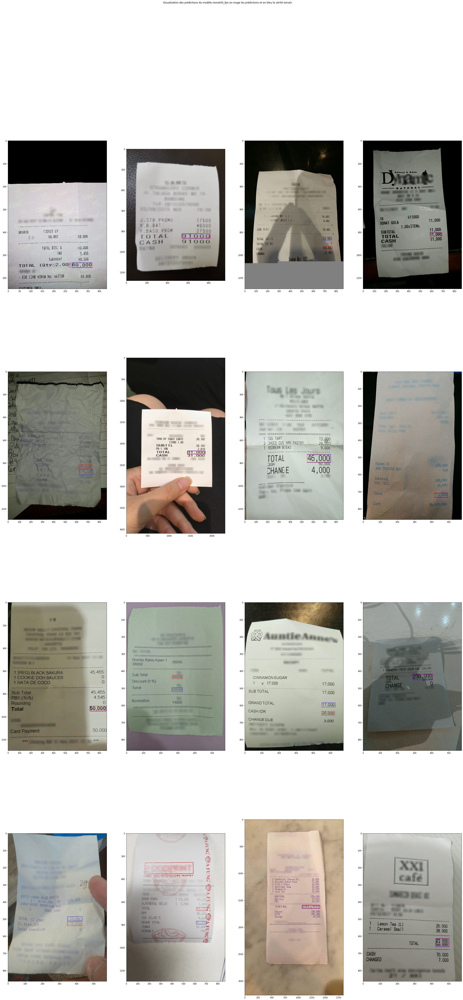

In [24]:


#visualisation des prédictions
image = transforms.Compose([transforms.ToTensor()])
dataset_test = Image_Rectangle('/content/drive/MyDrive/', 'test', image)
visualize_prediction(model,dataset_test, 4, 4)